# Grassmannian Interpolation

**Input to create interpolator**:

- Nominal airfoil (2D) shapes defining cross sections to be interpolated
- Locations of these shapes along the span-wise direction (`eta`)

**Wind turbine blade definitions from YAML file**:

Often, a wind turbine blade definition is encoded in a YAML file which contains nominal airfoil cross sections (normalized to have unit chord), their location along the blade span (`eta`), and profiles of pitch axis (axis of twist), pitch angle (twist), chordal scaling, and translations.

Our routine for blade interpolation consists of the following steps:

  1. Read the blade definition from the YAML file and reparametrize input airfoils so they have an equal number of landmarks with consistent landmark distribution
  2. Interpolate consistent shapes between given cross sections (maintain the nominal unit chord length)
  3. Apply affine deformations to the interpolated shapes to scale, rotate, shift and bend (out-of-plane rotation) the blade according to the given profiles.

This example can also be executed and customized as a script in `G2Aero/examples/blade_interpolation.py`. The script also demonstrates how a user can generate a mesh with Gmsh using the resulting blade interpolation as input.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from g2aero.yaml_info import YamlInfo
from g2aero.Grassmann_interpolation import GrassmannInterpolator
from g2aero.transform import TransformBlade, global_blade_coordinates

root_path = os.path.abspath(os.path.join(os.path.dirname("__file__"), os.pardir, os.pardir))
blades_path = os.path.join(root_path, 'data', 'blades_yamls')

## Reading a blade definition
We first create a class object `Blade` with information from  the YAML file and save `Blade.xy_landmarks` as 2D airfoil cross sections automatically reparametrized to have consistent landmarks. Then, `Blade.eta_nominal` stores the locations of the nominal airfoil cross sections along the normalized blade span positions (contained in 0 to 1) to define knots of the interpolator. Note that the number of landmarks is defined by the user and set to `n_landmarks=401` in this example.

Text(0.5, 1.0, 'Given nominal shapes')

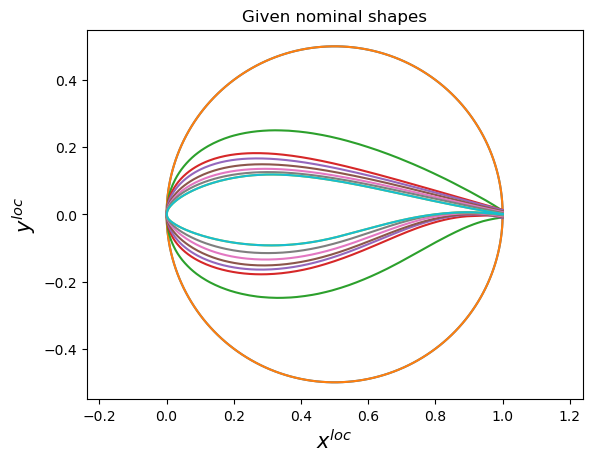

In [2]:
# shapes_filename = os.path.join(blades_path, 'nrel5mw_ofpolars.yaml')
shapes_filename = os.path.join(blades_path, 'IEA-15-240-RWT.yaml')
Blade = YamlInfo.init_from_yaml(shapes_filename, n_landmarks=401) 
xy_nominal = Blade.xy_landmarks 
eta_nominal = Blade.eta_nominal 

fig, ax = plt.subplots(1, 1)
for i, xy in enumerate(xy_nominal):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_xlabel(r'$x^{loc}$', fontsize=15)
ax.set_ylabel(r'$y^{loc}$', fontsize=15)
ax.set_title('Given nominal shapes')

## Interpolation Routine

Now we can create the interpolator `GrInterp` using the reparametrized nominal airfoils paired with their normalized span-wise position as inputs.

In [3]:
GrInterp = GrassmannInterpolator(eta_nominal, xy_nominal)

Next, we define a refined array of span-wise positions to generated new airfoil cross sections with the interpolator. We can provide any desired locations, e.g. 200 locations uniformly generated along the blade span or some alternative user definition.

In [4]:
eta_span = np.linspace(0, 1, 200)

Otherwise, we can use a built-in method to generate locations uniformly over cumulative Grassmannian distances to define a novel refinement over reparametrized blade span-wise positions. This method will generate more cross sections between nominal span-wise positions when shapes have a larger Grassmannian distance between them---offering a more prudent notion of how to refine the blade. Note that this method also has arguments `n_hub`, `n_tip`, `n_end`, which can help refine cross sections near the hub and near the tip in the event that the generated refinement is too sparse in these regions where structural implications are important or affine scales change dramatically. (see Technical Reference for details.)

In [5]:
eta_span = GrInterp.sample_eta(n_samples=200)

Next, we pass the array of desired locations to the interpolator to get interpolated shapes. The data `phys_crosssections` contains the sequence of 2D interpolated shapes (3D parallel cross sectional slices positioned orthogonally to the planar directions at `eta_space`) with unit chord.

Text(0.5, 1.0, 'Interpolated shapes')

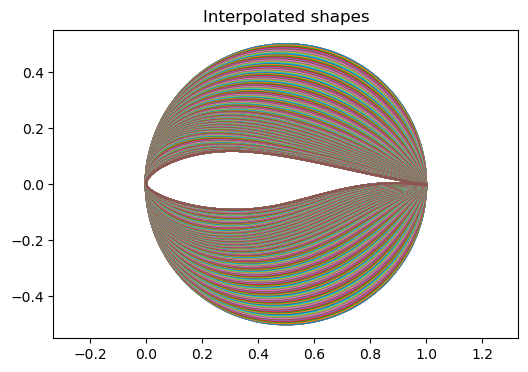

In [6]:
phys_crosssections, gr_crosssections = GrInterp(eta_span, grassmann=True)

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
for i, xy in enumerate(phys_crosssections):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_title("Interpolated shapes")

## Apply Affine transformations

Finally, we apply affine transformations (independent of our interpolation) to scale, rotate, shift and bend (out-of-plane rotation and translation) the blade according to the profiles provided in YAML file. 

In [7]:
M_yaml = Blade.M_yaml_interpolator
b_yaml = Blade.b_yaml_interpolator
b_pitch = Blade.pitch_axis
M = GrInterp.interpolator_M
b = GrInterp.interpolator_b

Transform = TransformBlade(M_yaml, b_yaml, b_pitch, M, b)
xyz_local = Transform.grassmann_to_phys(gr_crosssections, eta_span)
xyz_global = global_blade_coordinates(xyz_local)

Last, we visualize the resulting interpolated blade. Solid black-colored cross sections represent the nominal airfoil cross sections stored in the input YAML file while the blue wire-frame represents the specified interpolation.

In [8]:
import sys
sys.path.insert(0, '../')
from plot_helpfunctions import plot_3d_blade

nominal_shapes = global_blade_coordinates(Transform.grassmann_to_phys(GrInterp.xy_grassmann, eta_nominal))
plot_3d_blade(xyz_global, nominal_shapes)

## Example of propeller blade interpolation
Blade definition format in different engineering applications can vary. Our interpolation routine is desined to work with any blade (or, more generally, any tubular-like shapes) as long as nominal cross sections, their span-wise location (eta), and profiles of twist axis, twist angle,  scaling, and translations are provided.

As example, we demonstrate the model aircraft propeller blade interpolation using data from https://www.apcprop.com/technical-information/file-downloads/.

In [9]:
blade_filename = os.path.join(blades_path, 'propeller_blade', '10x47SF-PERF.PE0')
e63_filename = os.path.join(blades_path, 'propeller_blade', 'e63.dat')
naca4412_filename = os.path.join(blades_path, 'propeller_blade', 'NACA4412.dat')

### Read given profiles from the blade file
The file defining the propeller blade provides profiles of chord scaling (`CHORD`), LE shift in x coordinate (`SWEEP`) and twist angle (`TWIST`). This profiles are given with respect to location along the blade (`STATION`). 

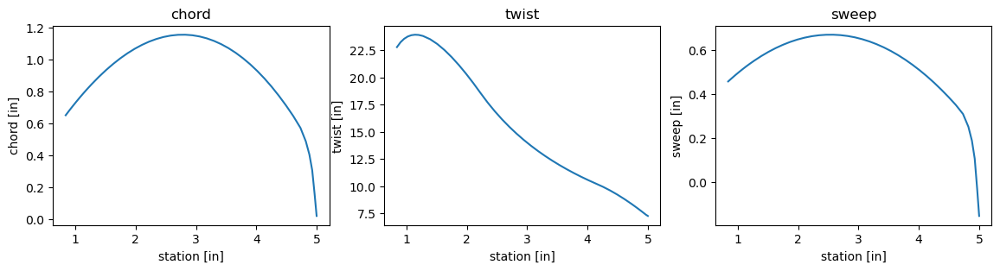

In [10]:
grid, chord_values, twist_values, sweep_values = [], [], [], []
with open(blade_filename, 'r') as f:
    lines = f.readlines()[28:70]
    for line in lines:
        l = line.strip().split('     ')
        grid.append(float(l[0]))
        chord_values.append(float(l[1]))
        sweep_values.append(float(l[5]))
        twist_values.append(float(l[7]))
# Plot given profiles
profiles = ['chord', 'twist', 'sweep']
fig, ax = plt.subplots(1, 3, figsize=(14, 3))
ax[0].plot(grid, chord_values)
ax[1].plot(grid, twist_values)
ax[2].plot(grid, sweep_values)
for i in range(3):
    ax[i].set_xlabel('station [in]')
    ax[i].set_ylabel(f'{profiles[i]} [in]')
    ax[i].set_title(f'{profiles[i]}')

### Read airfoils data and reparametrize them
Note that there are only two different airfoils cross sections in this blade. The primary airfoil shape used thought out the blade is Eppler E63 airfoil and at the tip it transitions to airfoil similar to NACA 4412. 

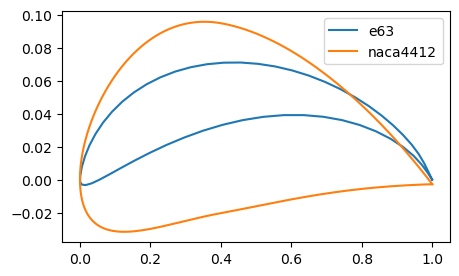

In [11]:
e63 = np.loadtxt(e63_filename, skiprows=1)
naca4412 = np.loadtxt(naca4412_filename, skiprows=1)

fig, ax = plt.subplots(1, 1, figsize=(5, 3))
ax.plot(e63[:, 0], e63[:, 1], label='e63')
ax.plot(naca4412[:, 0], naca4412[:, 1], label='naca4412')
ax.legend()

In [12]:
from g2aero.reparametrization import get_landmarks
from g2aero.utils import position_airfoil

n_airfoils_before_transition = 6
eta_nominal = np.linspace(grid[0], 4.90, n_airfoils_before_transition)
eta_nominal = np.append(eta_nominal, grid[-1])
print('positions of baseline airfoils:', eta_nominal)
xy_fromfile = [e63]*n_airfoils_before_transition
xy_fromfile.append(naca4412)
n_landmarks = 401
xy_nominal = np.empty((len(xy_fromfile), n_landmarks, 2))
for i, xy in enumerate(xy_fromfile):
    xy_reparametrized = get_landmarks(xy, n_landmarks=n_landmarks, method='CST', add_gap=0.0001)
    xy_nominal[i] = position_airfoil(xy_reparametrized, LE_cst=True)

positions of baseline airfoils: [0.8398  1.65184 2.46388 3.27592 4.08796 4.9     5.     ]


### Make YamlInfo object 

In [13]:
pitch_axis_values = np.ones_like(grid)*0.25  #2D rotation according 1/4 chord 
x_shift = 0.25*np.array(chord_values) - np.array(sweep_values) # sweep according LE
y_shift = np.zeros_like(grid)
shift_values = np.vstack((x_shift, y_shift, grid)).T
info = YamlInfo(eta_nominal, xy_nominal, 
                grid, chord_values, 
                grid, np.deg2rad(twist_values),
                grid, pitch_axis_values,
                grid, shift_values)

eta_nominal = info.eta_nominal
xy_nominal = info.xy_nominal

(200, 3)


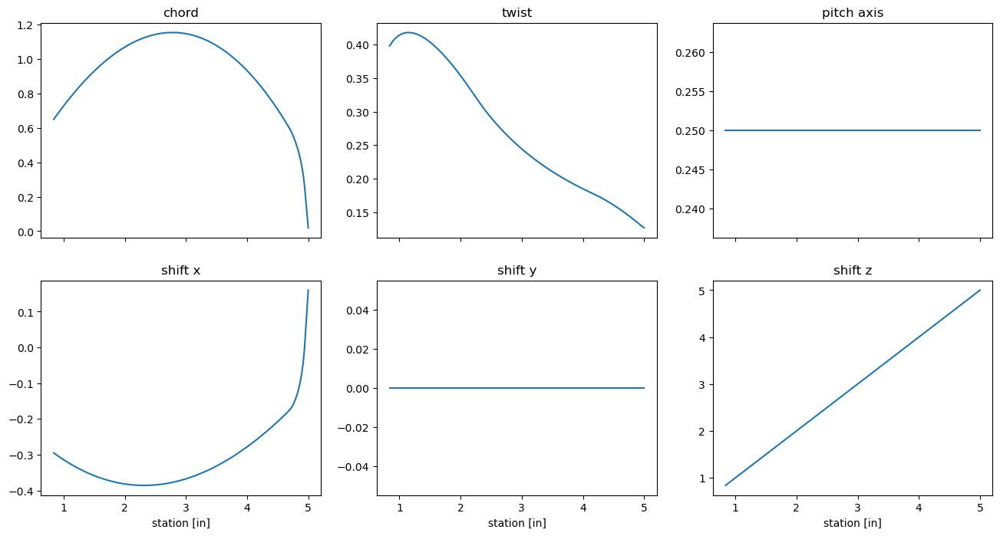

In [14]:
eta_grid = np.linspace(grid[0], grid[-1], 200)
fig, ax = plt.subplots(2, 3, figsize=(16, 8), sharex='col')
ax[0, 0].plot(eta_grid, info.chord(eta_grid))
ax[0, 0].set_title('chord')
ax[0, 1].plot(eta_grid, info.twist(eta_grid))
ax[0, 1].set_title('twist')
ax[0, 2].plot(eta_grid, info.pitch_axis(eta_grid))
ax[0, 2].set_title('pitch axis')

print(info.shift(eta_grid).shape)
ax[1, 0].plot(eta_grid, info.shift(eta_grid)[:, 0])
ax[1, 0].set_title('shift x')
ax[1, 1].plot(eta_grid, info.shift(eta_grid)[:, 1])
ax[1, 1].set_title('shift y')
ax[1, 2].plot(eta_grid, info.shift(eta_grid)[:, 2])
ax[1, 2].set_title('shift z')
for i in range(3):
    ax[1, i].set_xlabel('station [in]')

### Interpolation Routine

In [15]:
GrInterp = GrassmannInterpolator(eta_nominal, xy_nominal)

eta_new = GrInterp.sample_eta(50, n_hub=40, n_end=0)
phys_crosssections, gr_crosssections = GrInterp(eta_new, grassmann=True)

### Apply Affine transformations

Finally, we apply affine transformations (independent of our interpolation) to scale, rotate and shift the blade according to the provided profiles. 

In [16]:
M_yaml = info.M_yaml_interpolator
b_yaml = info.b_yaml_interpolator
b_pitch = info.pitch_axis
M = GrInterp.interpolator_M
b = GrInterp.interpolator_b

Transform = TransformBlade(M_yaml, b_yaml, b_pitch, M, b)
xyz_local = Transform.grassmann_to_phys(gr_crosssections, eta_new)

nominal_shapes = Transform.grassmann_to_phys(GrInterp.xy_grassmann, eta_nominal)
plot_3d_blade(xyz_local, nominal_shapes)